<a href="https://colab.research.google.com/github/thetushargoyal/reinforcement-learning-project/blob/main/Working_VISTA_Simulator.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Import Tensorflow 2.0
!pip install tensorflow==2.8.0 &> /dev/null
!pip install --upgrade git+https://github.com/aamini/introtodeeplearning.git &> /dev/null
#Install some dependencies for visualizing the agents
!apt-get install -y xvfb python-opengl x11-utils &> /dev/null
!pip install gym pyvirtualdisplay scikit-video ffio pyrender &> /dev/null
!pip install tensorflow_probability==0.12.0 &> /dev/null
!pip3 install mxnet-mkl==1.6.0 numpy==1.23.1
!pip install descartes
!pip install shapely==1.8.5

  Using cached descartes-1.1.0-py3-none-any.whl (5.8 kB)


In [ ]:
import os
import numpy as np
import matplotlib, cv2
import matplotlib.pyplot as plt
import base64, io, os, time, gym
import IPython, functools
import time
from tqdm import tqdm
import tensorflow_probability as tfp
import mitdeeplearning as mdl
import tensorflow as tf

os.environ['PYOPENGL_PLATFORM'] = 'egl'

In [ ]:
class Memory:
    def __init__(self):
        '''
        Initializes a Memory object with empty lists for observations, actions, and rewards.
        '''
        self.clear()

    def clear(self):
        '''
        Clears the memory buffer by resetting all lists.
        '''
        self.observations = []  # List to store observations
        self.actions = []       # List to store actions
        self.rewards = []       # List to store rewards

    def add_to_memory(self, new_observation, new_action, new_reward):
        '''
        Adds new observation, action, and reward to the memory buffer.

        Parameters:
            new_observation: The new observation to add.
            new_action: The new action taken.
            new_reward: The reward received for the action.
        '''
        self.observations.append(new_observation)  # Append new observation
        self.actions.append(new_action)            # Append new action
        self.rewards.append(new_reward)            # Append new reward

    def __len__(self):
        '''
        Returns the number of actions stored in the memory buffer.

        Returns:
            Length of actions list.
        '''
        return len(self.actions)

In [ ]:
def normalize(x):
    '''
    Normalizes a numpy array 'x' by subtracting its mean and dividing by its standard deviation.

    Parameters:
        x (np.array): The input array to be normalized.

    Returns:
        normalized_x (np.array): The normalized version of the input array.
    '''
    x -= np.mean(x)  # Subtract the mean of the array from each element
    x /= np.std(x)   # Divide each element by the standard deviation of the array
    return x.astype(np.float32)  # Return the normalized array as float32 datatype

def discount_rewards(rewards, gamma=0.95):
    '''
    Computes normalized, discounted, cumulative rewards (i.e., return).

    This function takes in the rewards received at each timestep during an episode
    and computes the discounted cumulative rewards, which are then normalized.

    Parameters:
        rewards (np.array): The rewards obtained at each timestep in the episode.
        gamma (float): The discounting factor for future rewards. Default is 0.95.

    Returns:
        normalized_discounted_rewards (np.array): The normalized discounted cumulative rewards.
    '''
    discounted_rewards = np.zeros_like(rewards)  # Initialize an array for discounted rewards
    R = 0  # Initialize the total discounted reward

    # Iterate through the rewards in reverse order
    for t in reversed(range(0, len(rewards))):
        # Update the total discounted reward
        R = R * gamma + rewards[t]
        # Assign the total discounted reward to the corresponding timestep
        discounted_rewards[t] = R

    # Normalize the discounted rewards using the helper function
    normalized_discounted_rewards = normalize(discounted_rewards)

    return normalized_discounted_rewards

In [ ]:
def compute_loss(logits, actions, rewards):
    '''
    Computes the policy gradient loss.

    This function calculates the loss for a policy gradient method using the
    logits (unnormalized probabilities) predicted by a neural network, the
    actions taken, and the corresponding rewards received.

    Parameters:
        logits (tensor): The unnormalized log probabilities output by the neural network.
        actions (tensor): The actions taken by the agent.
        rewards (tensor): The rewards received for each action.

    Returns:
        loss (tensor): The computed loss, which is the negative log probability
                       of the actions scaled by the rewards.

    '''

    # Calculate the negative log probabilities of the actions using softmax cross entropy
    neg_logprob = tf.nn.sparse_softmax_cross_entropy_with_logits(
        logits=logits, labels=actions)

    # Scale the negative log probabilities by the rewards to compute the loss
    loss = tf.reduce_mean(neg_logprob * rewards)

    return loss

In [ ]:
def train_step(model, loss_function, optimizer, observations, actions, discounted_rewards, custom_fwd_fn=None):
    '''
    Performs a single training step for the agent network.

    This function computes the loss based on the predicted actions and discounted rewards,
    computes gradients of the loss with respect to the model's trainable variables,
    clips the gradients to prevent exploding gradients, and applies the gradients to update the model.

    Parameters:
        model (tf.keras.Model): The agent network model.
        loss_function: The loss function used to compute the loss.
        optimizer: The optimizer used to update the model's parameters.
        observations: The observations input to the model.
        actions: The actions taken by the agent.
        discounted_rewards: The normalized, discounted rewards received by the agent.
        custom_fwd_fn (function): An optional custom forward function for the model.

    '''
    with tf.GradientTape() as tape:
        # Forward propagate through the agent network
        if custom_fwd_fn is not None:
            prediction = custom_fwd_fn(observations)
        else:
            prediction = model(observations)

        # Call the compute_loss function to compute the loss
        loss = loss_function(prediction, actions, discounted_rewards)

    # Compute gradients of the loss with respect to model's trainable variables
    grads = tape.gradient(loss, model.trainable_variables)

    # Clip gradients to prevent exploding gradients
    grads, _ = tf.clip_by_global_norm(grads, 2)

    # Apply gradients to update the model's parameters
    optimizer.apply_gradients(zip(grads, model.trainable_variables))

In [ ]:
!pip install --upgrade vista
import vista
from vista.utils import logging
logging.setLevel(logging.ERROR)
?vista.Display

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.3/60.3 kB 2.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for vista: filename=vista-2.0.6-py3-none-any.whl size=73900 sha256=2907777f261f177d69d86353cadc017de72b48f1d2b704a7bccf2803a5268e6e
  Stored in directory: /root/.cache/pip/wheels/1f/85/10/6503a8febfee090e49e7a5bfd5cdc4e7edcd941ae20566b80a
Successfully built vista


2024-03-25 18:35:03,127::WARNING::[vista.entities.sensors.EventCamera.<module>] Fail to import module for event camera. Remember to do source <some-dir>/openeb/build/utils/scripts/setup_env.shCan ignore this if not using it


In [ ]:
# Download and extract the data for vista (auto-skip if already downloaded)
!wget -nc -q --show-progress https://www.dropbox.com/s/62pao4mipyzk3xu/vista_traces.zip
print("Unzipping data...")
!unzip -o -q vista_traces.zip
print("Done downloading and unzipping data!")

trace_root = "./vista_traces"
trace_path = [
    "20210726-154641_lexus_devens_center",
    "20210726-155941_lexus_devens_center_reverse",
    "20210726-184624_lexus_devens_center",
    "20210726-184956_lexus_devens_center_reverse",
]
trace_path = [os.path.join(trace_root, p) for p in trace_path]

# Create a virtual world with VISTA, the world is defined by a series of data traces
world = vista.World(trace_path, trace_config={'road_width': 4})

# Create a car in our virtual world. The car will be able to step and take different
#   control actions. As the car moves, its sensors will simulate any changes it environment
car = world.spawn_agent(
    config={
        'length': 5.,
        'width': 2.,
        'wheel_base': 2.78,
        'steering_ratio': 14.7,
        'lookahead_road': True
    })

# Create a camera on the car for synthesizing the sensor data that we can use to train with!
camera = car.spawn_camera(config={'size': (200, 320)})

# Define a rendering display so we can visualize the simulated car camera stream and also
#   get see its physical location with respect to the road in its environment.
display = vista.Display(world, display_config={"gui_scale": 2, "vis_full_frame": False})

# Define a simple helper function that allows us to reset VISTA and the rendering display
def vista_reset():
    world.reset()
    display.reset()
# vista_reset()

vista_traces.zip    100%[===================>] 609.05M  73.1MB/s    in 10s     
Unzipping data...
Done downloading and unzipping data!


NameError: name 'os' is not defined

In [ ]:
# First we define a step function, to allow our virtual agent to step
# with a given control command through the environment
# agent can act with a desired curvature (turning radius, like steering angle)
# and desired speed. if either is not provided then this step function will
# use whatever the human executed at that time in the real data.

def vista_step(curvature=None, speed=None):
    # Arguments:
    #   curvature: curvature to step with
    #   speed: speed to step with
    if curvature is None:
        curvature = car.trace.f_curvature(car.timestamp)
    if speed is None:
        speed = car.trace.f_speed(car.timestamp)

    car.step_dynamics(action=np.array([curvature, speed]), dt=1/15.)
    car.step_sensors()

In [ ]:
import shutil, os, subprocess, cv2

# Create a simple helper class that will assist us in storing videos of the render
class VideoStream():
    def __init__(self):
        self.tmp = "./tmp"
        if os.path.exists(self.tmp) and os.path.isdir(self.tmp):
            shutil.rmtree(self.tmp)
        os.mkdir(self.tmp)
    def write(self, image, index):
        cv2.imwrite(os.path.join(self.tmp, f"{index:04}.png"), image)
    def save(self, fname):
        cmd = f"/usr/bin/ffmpeg -f image2 -i {self.tmp}/%04d.png -crf 0 -y {fname}"
        subprocess.call(cmd, shell=True)

In [ ]:
## Render and inspect a human trace ##

vista_reset()
stream = VideoStream()

for i in tqdm(range(100)):
    vista_step()

    # Render and save the display
    vis_img = display.render()
    stream.write(vis_img[:, :, ::-1], index=i)
    if car.done:
        break

print("Saving trajectory of human following...")
stream.save("human_follow.mp4")
mdl.lab3_old.play_video("human_follow.mp4")

/usr/local/lib/python3.10/dist-packages/ffio/ffio.py:78: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  self.image =  np.fromstring(raw_image, dtype='uint8')
/usr/local/lib/python3.10/dist-packages/OpenGL/images.py:137: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  return data.tostring()
  0%|          | 0/100 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/descartes/patch.py:62: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  vertices = concatenate([
100%|██████████| 100/100 [02:52<00:00,  1.72s/it]


Saving trajectory of human following...


In [ ]:
## Define terminal states and crashing conditions ##

def check_out_of_lane(car):
    distance_from_center = np.abs(car.relative_state.x)
    road_width = car.trace.road_width
    half_road_width = road_width / 2
    return distance_from_center > half_road_width

def check_exceed_max_rot(car):
    maximal_rotation = np.pi / 10.
    current_rotation = np.abs(car.relative_state.yaw)
    return current_rotation > maximal_rotation

def check_crash(car):
    return check_out_of_lane(car) or check_exceed_max_rot(car) or car.done

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
## Behavior with random control policy ##

i = 0
num_crashes = 5
stream = VideoStream()

for _ in range(num_crashes):
    vista_reset()

    while not check_crash(car):

        # Sample a random curvature (between +/- 1/3), keep speed constant
        curvature = np.random.uniform(-1/3, 1/3)

        # Step the simulated car with the same action
        vista_step(curvature=curvature)

        # Render and save the display
        vis_img = display.render()
        stream.write(vis_img[:, :, ::-1], index=i)
        i += 1

    print(f"Car crashed on step {i}")
    for _ in range(5):
        stream.write(vis_img[:, :, ::-1], index=i)
        i += 1

print("Saving trajectory with random policy...")
stream.save("random_policy.mp4")
mdl.lab3_old.play_video("random_policy.mp4")

/usr/local/lib/python3.10/dist-packages/ffio/ffio.py:78: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  self.image =  np.fromstring(raw_image, dtype='uint8')
/usr/local/lib/python3.10/dist-packages/OpenGL/images.py:137: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  return data.tostring()
/usr/local/lib/python3.10/dist-packages/descartes/patch.py:62: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  vertices = concatenate([


Car crashed on step 9


/usr/local/lib/python3.10/dist-packages/ffio/ffio.py:78: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  self.image =  np.fromstring(raw_image, dtype='uint8')
/usr/local/lib/python3.10/dist-packages/OpenGL/images.py:137: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  return data.tostring()
/usr/local/lib/python3.10/dist-packages/descartes/patch.py:62: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  vertices = concatenate([


Car crashed on step 36


/usr/local/lib/python3.10/dist-packages/ffio/ffio.py:78: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  self.image =  np.fromstring(raw_image, dtype='uint8')
/usr/local/lib/python3.10/dist-packages/OpenGL/images.py:137: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  return data.tostring()
/usr/local/lib/python3.10/dist-packages/descartes/patch.py:62: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  vertices = concatenate([


Car crashed on step 43


/usr/local/lib/python3.10/dist-packages/ffio/ffio.py:78: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  self.image =  np.fromstring(raw_image, dtype='uint8')
/usr/local/lib/python3.10/dist-packages/OpenGL/images.py:137: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  return data.tostring()
/usr/local/lib/python3.10/dist-packages/descartes/patch.py:62: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  vertices = concatenate([


Car crashed on step 58


/usr/local/lib/python3.10/dist-packages/ffio/ffio.py:78: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  self.image =  np.fromstring(raw_image, dtype='uint8')
/usr/local/lib/python3.10/dist-packages/OpenGL/images.py:137: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  return data.tostring()
/usr/local/lib/python3.10/dist-packages/descartes/patch.py:62: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  vertices = concatenate([


Car crashed on step 70
Saving trajectory with random policy...


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/ffio/ffio.py:78: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  self.image =  np.fromstring(raw_image, dtype='uint8')
/usr/local/lib/python3.10/dist-packages/OpenGL/images.py:137: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  return data.tostring()


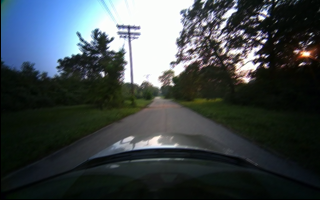

In [ ]:
from google.colab.patches import cv2_imshow

# Directly access the raw sensor observations of the simulated car
vista_reset()
full_obs = car.observations[camera.name]
cv2_imshow(full_obs)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


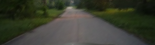

In [ ]:
## ROIs ##

# Crop a smaller region of interest (ROI). This is necessary because:
#   1. The full observation will have distortions on the edge as the car deviates from the human
#   2. A smaller image of the environment will be easier for our model to learn from
region_of_interest = camera.camera_param.get_roi()
i1, j1, i2, j2 = region_of_interest
cropped_obs = full_obs[i1:i2, j1:j2]
cv2_imshow(cropped_obs)

In [ ]:
## Data preprocessing functions ##

def preprocess(full_obs):
    # Extract ROI
    i1, j1, i2, j2 = camera.camera_param.get_roi()
    obs = full_obs[i1:i2, j1:j2]

    # Rescale to [0, 1]
    obs = obs / 255.
    return obs

def grab_and_preprocess_obs(car):
    full_obs = car.observations[camera.name]
    obs = preprocess(full_obs)
    return obs

In [ ]:
### Define the self-driving agent ###
# Note: we start with a template CNN architecture -- experiment away as you
#   try to optimize your agent!

# Functionally define layers for convenience
# All convolutional layers will have ReLu activation
act = tf.keras.activations.swish
Conv2D = functools.partial(tf.keras.layers.Conv2D, padding='valid', activation=act)
Flatten = tf.keras.layers.Flatten
Dense = tf.keras.layers.Dense

# Defines a CNN for the self-driving agent
def create_driving_model():
    model = tf.keras.models.Sequential([
        Conv2D(filters=32, kernel_size=5, strides=2),
        Conv2D(filters=48, kernel_size=5, strides=2),
        Conv2D(filters=64, kernel_size=3, strides=2),
        Conv2D(filters=64, kernel_size=3, strides=2),
        Flatten(),
        Dense(units=128, activation=act),
        Dense(units=2, activation=None)
    ])
    return model

driving_model = create_driving_model()

In [ ]:
## The self-driving learning algorithm ##

# hyperparameters
max_curvature = 1/8.
max_std = 0.1

def run_driving_model(image):
    # Arguments:
    #   image: an input image
    # Returns:
    #   pred_dist: predicted distribution of control actions
    single_image_input = tf.rank(image) == 3  # missing 4th batch dimension
    if single_image_input:
        image = tf.expand_dims(image, axis=0)

    distribution = driving_model(image) # TODO
    # distribution = ''' TODO '''

    mu, logsigma = tf.split(distribution, 2, axis=1)
    mu = max_curvature * tf.tanh(mu) # conversion
    sigma = max_std * tf.sigmoid(logsigma) + 0.005 # conversion

    pred_dist = tfp.distributions.Normal(mu, sigma) # TODO
    # pred_dist = ''' TODO '''
    return pred_dist


def compute_driving_loss(dist, actions, rewards):
    # Arguments:
    #   logits: network's predictions for actions to take
    #   actions: the actions the agent took in an episode
    #   rewards: the rewards the agent received in an episode
    # Returns:
    #   loss
    neg_logprob = -1 * dist.log_prob(actions)

    loss = tf.reduce_mean( neg_logprob * rewards )
    return loss


In [ ]:


''' TODO: Learning rate and optimizer '''
learning_rate = 5e-4
optimizer = tf.keras.optimizers.Adam(learning_rate)

# instantiate driving agent
vista_reset()
driving_model = create_driving_model()
# NOTE: the variable driving_model will be used in run_driving_model execution

# to track our progress
smoothed_reward = mdl.util.LossHistory(smoothing_factor=0.9)
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Rewards')

# instantiate Memory buffer
memory = Memory()

/usr/local/lib/python3.10/dist-packages/ffio/ffio.py:78: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  self.image =  np.fromstring(raw_image, dtype='uint8')
/usr/local/lib/python3.10/dist-packages/OpenGL/images.py:137: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  return data.tostring()


In [ ]:
## Driving training! Main training block. ##
## Note: stopping and restarting this cell will pick up training where you
#        left off. To restart training you need to rerun the cell above as
#        well (to re-initialize the model and optimizer)

max_batch_size = 300
max_reward = float('-inf') # keep track of the maximum reward acheived during training
if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists
for i_episode in range(20):

    plotter.plot(smoothed_reward.get())
    # Restart the environment
    vista_reset()
    memory.clear()
    observation = grab_and_preprocess_obs(car)

    while True:

        curvature_dist = run_driving_model(observation)

        curvature_action = curvature_dist.sample()[0,0]

        # Step the simulated car with the same action
        vista_step(curvature_action)
        observation = grab_and_preprocess_obs(car)
        reward = 1.0 if not check_crash(car) else 0.0

        # add to memory
        memory.add_to_memory(observation, curvature_action, reward)
        # print(memory)

        # is the episode over? did you crash or do so well that you're done?
        if reward == 0.0:
            # determine total reward and keep a record of this
            total_reward = sum(memory.rewards)
            smoothed_reward.append(total_reward)

            # execute training step - remember we don't know anything about how the
            #   agent is doing until it has crashed! if the training step is too large
            #   we need to sample a mini-batch for this step.
            batch_size = min(len(memory), max_batch_size)
            i = np.random.choice(len(memory), batch_size, replace=False)
            train_step(driving_model, compute_driving_loss, optimizer,
                               observations=np.array(memory.observations)[i],
                               actions=np.array(memory.actions)[i],
                               discounted_rewards = discount_rewards(memory.rewards)[i],
                               custom_fwd_fn=run_driving_model)
            # reset the memory
            memory.clear()
            break

In [ ]:
## Evaluation block!##

i_step = 0
num_episodes = 5
num_reset = 5
stream = VideoStream()
for i_episode in range(num_episodes):

    # Restart the environment
    vista_reset()
    observation = grab_and_preprocess_obs(car)

    print("rolling out in env")
    episode_step = 0
    while not check_crash(car) and episode_step < 100:
        # using our observation, choose an action and take it in the environment
        curvature_dist = run_driving_model(observation)
        curvature = curvature_dist.mean()[0,0]

        # Step the simulated car with the same action
        vista_step(curvature)
        observation = grab_and_preprocess_obs(car)

        vis_img = display.render()
        stream.write(vis_img[:, :, ::-1], index=i_step)
        i_step += 1
        episode_step += 1

    for _ in range(num_reset):
        stream.write(np.zeros_like(vis_img), index=i_step)
        i_step += 1

print(f"Average reward: {(i_step - (num_reset*num_episodes)) / num_episodes}")

print("Saving trajectory with trained policy...")
stream.save("trained_policy.mp4")


In [ ]:
mdl.lab3_old.play_video("trained_policy.mp4")